In [1]:
import pandas as pd
import numpy as np
from tqdm.notebook import tqdm

import plotly.graph_objs as go
from plotly.subplots import make_subplots
import plotly.io as pio

from xgboost import XGBRegressor, XGBClassifier
import pickle

import warnings
warnings.filterwarnings("ignore")

In [2]:
def plot_multiclass_roc(clf, X_test, y_test, n_classes, figsize=(17, 6)):
    y_score = clf.predict_proba(X_test)

    fpr = dict()
    tpr = dict()
    roc_auc = dict()

    y_test_dummies = pd.get_dummies(y_test, drop_first=False).values
    for i in range(n_classes):
        fpr[i], tpr[i], _ = roc_curve(y_test_dummies[:, i], y_score[:, i])
        roc_auc[i] = auc(fpr[i], tpr[i])

    fig, ax = plt.subplots(figsize=figsize)
    ax.plot([0, 1], [0, 1], 'k--')
    ax.set_xlim([0.0, 1.0])
    ax.set_ylim([0.0, 1.05])
    ax.set_xlabel('False Positive Rate')
    ax.set_ylabel('True Positive Rate')
    ax.set_title('Receiver operating characteristic example')
    for i in range(n_classes):
        ax.plot(fpr[i], tpr[i], label=f'ROC curve (area = {roc_auc[i].round(4)}) for label {i}')
    ax.legend(loc="best")
    ax.grid(alpha=.4)
    sns.despine()
    plt.show()

In [3]:
path='/mnt/cephfs/ml_data/mc_2021/'

In [4]:
opt_features = ['AccumCharge', 'R_cht', 'z_cc', 'pe_std',
                'nPMTs', 'ht_kurtosis', 'ht_25-20p', 'R_cc',
                'ht_5-2p', 'pe_mean', 'jacob_cht', 'phi_cc',
                'ht_35-30p', 'ht_20-15p', 'pe_35p', 'ht_30-25p']
opt_features += ['edep']

In [5]:
data = pd.read_csv('{}processed_data/ProcessedTrainReal/ProcessedTrain.csv.gz'.format(path))
data = data[data['edepR'] < 17.2]
data_first_subdet = data[data['edepR'] < 15][opt_features]
data_second_subdet = data[(data['edepR'] >= 15) & (data['edepR'] < 16)][opt_features]
data_third_subdet = data[data['edepR'] >= 16][opt_features]

In [6]:
data['subdetector_class'] = 0
data['subdetector_class'].loc[data_second_subdet.index] = 1
data['subdetector_class'].loc[data_third_subdet.index] = 2

In [7]:
all_data = [data_first_subdet, data_second_subdet, data_third_subdet]

In [8]:
from sklearn.model_selection import train_test_split

X_clf_train, X_clf_val, y_clf_train, y_clf_val = train_test_split(
    data[opt_features[:-1]], data.iloc[:, -1], test_size=0.1, random_state=22)

In [9]:
# clf = XGBClassifier(
#                 learning_rate=0.08,
#                 n_estimators=5000,
#                 random_state=22,
#                 objective='multi:softmax',
#                 tree_method='gpu_hist'
# )

In [10]:
from sklearn.model_selection import GridSearchCV

# params = {
#     "max_depth": range(1, 15)
# }

# fit_params={
#     "early_stopping_rounds": 5, 
#     "eval_metric": ['mlogloss'], 
#     "eval_set" : [(X_clf_val, y_clf_val)],
# }

# gridsearch = GridSearchCV(
#                 clf,
#                 cv=5,
#                 verbose=False,
#                 param_grid=params,
# )

# gridsearch.fit(X_clf_train, y_clf_train, **fit_params,)

In [11]:
best_max_depth = 2#gridsearch.best_params_['max_depth']
best_max_depth

2

In [12]:
clf = XGBClassifier(
                max_depth=best_max_depth,
                learning_rate=0.3,
                n_estimators=3000,
                random_state=22,
                objective='multi:softmax',
                tree_method='gpu_hist'
)

In [13]:
clf.fit(
       X_clf_train, y_clf_train, verbose=False,
       eval_set=[(X_clf_val, y_clf_val)],
       eval_metric=['mlogloss'],
       early_stopping_rounds=5
)

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=0,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.3, max_delta_step=0, max_depth=2,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=3000, n_jobs=20, num_parallel_tree=1,
              objective='multi:softprob', random_state=22, reg_alpha=0,
              reg_lambda=1, scale_pos_weight=None, subsample=1,
              tree_method='gpu_hist', validate_parameters=1, verbosity=None)

In [14]:
pickle.dump(clf, open("three_subs/models/subdetector_clf.dat", "wb"))

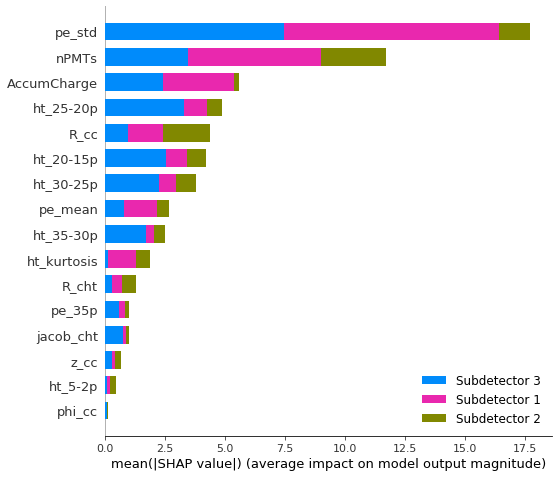

In [15]:
import shap

clf_shap_values = shap.TreeExplainer(clf).shap_values(X_clf_val[:10000])
shap.summary_plot(clf_shap_values, X_clf_val[:10000], plot_type='bar',
                  class_names=['Subdetector 1', 'Subdetector 2', 'Subdetector 3'])

0.9841305348750337

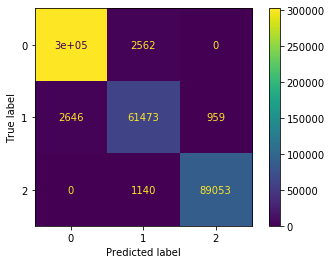

In [16]:
from sklearn.metrics import plot_confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn.metrics import plot_roc_curve

plot_confusion_matrix(clf, X_clf_val, y_clf_val);
accuracy_score(y_clf_val, clf.predict(X_clf_val))

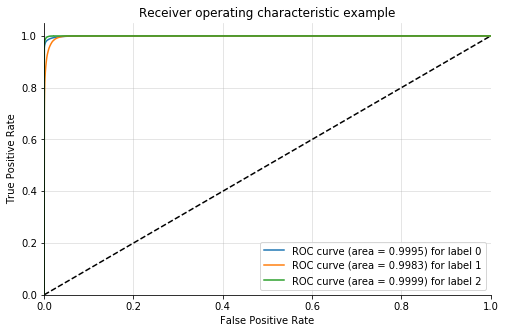

In [17]:
from sklearn.metrics import roc_curve, auc
import matplotlib.pyplot as plt
import seaborn as sns

plot_multiclass_roc(clf, X_clf_val, y_clf_val, n_classes=3, figsize=(8, 5))

In [18]:
X_trains = []
y_trains = []

X_vals = []
y_vals = []

for i in range(len(all_data)):
    X = all_data[i][opt_features].iloc[:, :-1]
    y = all_data[i].iloc[:, -1]
    
    X_train, X_val, y_train, y_val = train_test_split(
        X, y, test_size=0.1, random_state=22)
    
    X_trains.append(X_train)
    y_trains.append(y_train)
    
    X_vals.append(X_val)
    y_vals.append(y_val)

In [19]:
train = input()
if train == 'yes':
    train = True
else:
    train = False

no


In [20]:
if train:
    models = []
    for i in tqdm(range(len(all_data))):
        model = XGBRegressor(
                max_depth=10,
                learning_rate=0.08,
                n_estimators=3000,
                random_state=22,
        )

        model.fit(X_trains[i], y_trains[i], verbose=False,
                   eval_set=[(X_vals[i], y_vals[i])],
                   eval_metric=['rmse'],
                   early_stopping_rounds=7)

        models.append(model)
        pickle.dump(model, open(f"three_subs/models/xgb_energy_sub_{i}.dat", "wb"))

In [21]:
models = []
for i in tqdm(range(len(all_data))):
    models.append(pickle.load(open(f"three_subs/models/xgb_energy_sub_{i}.dat", "rb")))

  0%|          | 0/3 [00:00<?, ?it/s]

In [22]:
energies = [0.1, 0.3, 0.6] + list(range(1, 10))
y_true_array = []
y_pred_array = []
for j in tqdm(range(len(all_data)), "Subdetectors..."):
    y_true = []
    y_pred = []
    for energy in tqdm(energies, "Energies...", leave=False):
        test = pd.read_csv(f'{path}processed_data/ProcessedTestReal/{energy}MeV.csv.gz')
        test = test[test['edepR'] < 17.2]
        test['subdetector_class'] = clf.predict(test[opt_features[:-1]])
        edep = np.array(test['edep'][test['subdetector_class']==j])
        X_test = test[opt_features][test['subdetector_class']==j].iloc[:, :-1]
        edep_preds = models[j].predict(np.array(X_test))

        y_true.append(edep)
        y_pred.append(edep_preds)
    y_true_array.append(y_true)
    y_pred_array.append(y_pred)

Subdetectors...:   0%|          | 0/3 [00:00<?, ?it/s]

Energies...:   0%|          | 0/12 [00:00<?, ?it/s]

Energies...:   0%|          | 0/12 [00:00<?, ?it/s]

Energies...:   0%|          | 0/12 [00:00<?, ?it/s]

In [23]:
diffs = np.array([
    [y_pred_array[j][i] - y_true_array[j][i] for i in range(len(y_pred_array[0]))]
    for j in range(len(y_pred_array))
])

In [24]:
energies = [0.1, 0.3, 0.6] + list(range(1, 10))
energies = np.array([1.022+i for i in energies]).round(5)
energies

array([ 1.122,  1.322,  1.622,  2.022,  3.022,  4.022,  5.022,  6.022,
        7.022,  8.022,  9.022, 10.022])

In [25]:
names = ['Subdetector: R=[0, 15] m.', 'Subdetector: R=[15, 16] m.', 'Subdetector: R=[16, 17.2] m.']

In [26]:
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit
from scipy.stats import norm

a_array = []
errors_array = []
for k in range(diffs.shape[0]):
    a = []
    e = []
    for i in range(diffs.shape[1]):
        fig, ax = plt.subplots()
        nbins = 150
        n, bins, patches = ax.hist(diffs[k][i], nbins, density=True, facecolor = 'grey', alpha = 0.5, label='before');
        plt.close(fig)
        centers = (0.5*(bins[1:]+bins[:-1]))
        pars, cov = curve_fit(lambda x, mu, sig : norm.pdf(x, loc=mu, scale=sig), centers, n, p0=[0,1])  
        a.append(pars)
        e.append(cov)
    a_array.append(a)
    errors_array.append(e)

In [27]:
pio.templates.default = 'plotly_white'

from scipy import stats
for k in range(len(all_data)):
    fig = go.Figure()

    for i in range(len(diffs[k])): 
        x = np.linspace(diffs[k][i][:22500].min(), diffs[k][i][:22500].max(), 100)
        p = stats.norm.pdf(x, a_array[k][i][0], a_array[k][i][1])

        fig.add_trace(go.Scatter(x=x,
                     y=p, mode='lines', name='mu={:.3f} +- {:.3f}, sigma={:.3f} +- {:.3f}'.format(
                         a_array[k][i][0], np.sqrt(errors_array[k][i][0][0]),
                         a_array[k][i][1], np.sqrt(errors_array[k][i][1][1])),
                        visible = (i==0)
                    ))

    for i in range(len(diffs[k])): 
        fig.add_trace(go.Histogram(x=diffs[k][i][:22500], xbins=dict(size=0.005),
                      showlegend=False, histnorm='probability density',
                     visible = (i==0)
                    ))

    buttons = []
    for N in range(0, len(diffs[k])): 
        buttons.append(
            dict(
                 args=['visible', [False]*N + [True] + [False]*(len(diffs[k])-1-N)],
                     label='Energy =  {} MeV'.format(energies[N]),
                 method='restyle'
            )
        )
        
    fig.update_layout(

        xaxis = dict(
            showline=True,
            ticks='outside',
            mirror=True,
            linecolor='black',
            showgrid=True,
            gridcolor='grey',
            gridwidth=0.25,
        ),

        yaxis = dict(
            showline=True,
            ticks='outside',
            mirror=True,
            linecolor='black',
            tick0=0,
#             dtick=1,
            showgrid=True,
            gridcolor='grey',
            gridwidth=0.25,
            zeroline=True,
            zerolinecolor='black',
            zerolinewidth=0.25
            ),
    )


    fig.update_layout(
        title = '{}'.format(names[k]),
        xaxis_title=r"$$E_{rec} - E_{true}$$",
#         yaxis_title="y",
        showlegend=True,
        updatemenus=list([
            dict(
                x=0.5,
                y=1.2,
                yanchor='top',
                buttons=buttons
            ),
        ]),
        legend=dict(
            orientation="h",
            yanchor="bottom",
            y=1.05,
            xanchor="right",
            x=1
        )
    )
    
    fig.show()

In [28]:
def plot_results(appr=False):

    fig = make_subplots(rows=2, cols=1,
                        shared_xaxes=True,
                        vertical_spacing=0.02,
                        row_width=[0.25, 0.75]
    )

    for k in range(diffs.shape[0]):
        fig.add_trace(
            go.Scatter(
                x=energies,
                y=res[k],
                mode='markers',
                marker=dict(
                    color=colors[k],
                    symbol=symbols[k]
                ),
                showlegend=True,
                error_y=dict(
                    type='data',
                    width=10,
                    array=error_sigma[k],
                    visible=True
                ),
                name=names[k]
            ), row=1, col=1
        )

        fig.add_trace(
            go.Scatter(
                x=energies,
                y=bias[k],
                mode='markers',
                showlegend=False,
                marker=dict(
                    color=colors[k],
                    symbol=symbols[k]
                ),
                error_y=dict(
                        type='data',
                        width=10,
                        array=error_mu[k],
                        visible=True
                ),
                name=names[k]
            ), row=2, col=1
        )

    if appr:
        for k in range(len(names)):
            fig.add_trace(
                go.Scatter(
                    x=x_lin,
                    y=func(x_lin, a[k], b[k], c[k]),
                    mode='lines',
                    line=dict(
                    ),
                    opacity=0.5,
                    showlegend=False,
                    name=names[k],
                    marker=dict(
                        color=colors[k]
                    )
                ), row=1, col=1
            )

    xaxis = dict(
        showline=True,
        ticks='outside',
        mirror=True,
        tick0=1,
        dtick=1,
        linecolor='black',
        showgrid=True,
        gridcolor='grey',
        gridwidth=0.25,
    )

    yaxis = lambda range: dict(
        showline=True,
        ticks='outside',
        mirror=True,
        linecolor='black',
        range=range,
        showgrid=True,
        gridcolor='grey',
        gridwidth=0.25,
        zeroline=True,
        zerolinecolor='black',
        zerolinewidth=0.25
    )

    fig.update_layout(
        xaxis2_title="Visible energy, MeV",
        yaxis1_title="Resolution, %",
        yaxis2_title="Bias, %",

        xaxis1 = xaxis,
        xaxis2 = xaxis,
        yaxis1 = yaxis([1, 3.5]),
        yaxis2 = yaxis([-0.25, 0.25]),

        showlegend=True,
        font=dict(
                family="Times New Roman",
                size=22,
        ),
        legend=dict(
            x=0.6,
            y=0.99,
            title_font_family="Times New Roman",
            font=dict(
                family="Times New Roman",
                size=22,
                color="black"
            ),
            bordercolor="Black",
            borderwidth=2
        )
    )

    fig.show()
    if appr:
        pio.write_image(
            fig, 'three_subs/plots/subdetectors_results_appr.pdf',
            width=900, height=600)
    else:
        pio.write_image(
            fig, 'three_subs/plots/subdetectors_results.pdf',
            width=900, height=600)

In [29]:
colors = ['red', 'darkviolet', 'blue']
symbols = ['hexagon-open', 'star-square', 1]

In [30]:
error_sigma = []
for k in range(diffs.shape[0]):
    error = [100 * np.sqrt(errors_array[k][i][1][1]) / energies[i] for i in range(len(energies))]
    error_sigma.append(error)
    
error_mu = []
for k in range(diffs.shape[0]):
    error = [100 * np.sqrt(errors_array[k][i][0][0]) / energies[i] for i in range(len(energies))]
    error_mu.append(error)

In [31]:
res = []
bias = []
for k in range(diffs.shape[0]):
    sigma = [100 * a_array[k][i][1] / energies[i] for i in range(len(energies))]
    mu = [100 * a_array[k][i][0] / energies[i] for i in range(len(energies))]
    res.append(sigma)
    bias.append(mu)
    
plot_results()

In [32]:
def a(x, a):
    return np.sqrt((a/x**0.5)**2)


def b(x, b):
    b_list = []
    b_list.append(np.sqrt(b**2))
    return b_list*len(x)


def c(x, c):
    return np.sqrt((c/x)**2)


def func(x, a, b, c):
    return np.sqrt((a/x**0.5)**2 + b**2 + (c/x)**2) 


def approximated(x, y, yerr):
    popt, pcov = curve_fit(func, x, y, sigma=yerr, maxfev=10**8, bounds=([0, 0, 0.25], [5, 5, 5]))
    a, b, c = popt
    #perr = np.sqrt(abs(pcov.diagonal()))

    return func(x, a, b, c), popt, pcov

In [33]:
from statsmodels.stats.moment_helpers import cov2corr

y_approximated_array = []
coefs_array = []
errors_array = []
corr_matrixes = []
for i in range(diffs.shape[0]):
    y_approximated, coefs, pcov = approximated(
        energies, res[i], error_sigma[i])
    y_approximated_array.append(y_approximated)
    coefs_array.append(coefs)
    errors_array.append(np.sqrt(abs(pcov.diagonal())))
    corr_matrixes.append(cov2corr(pcov))

corr_matrixes = np.array(corr_matrixes)

In [34]:
reindex = [0, 3, 1, 4, 2, 5]
coefs_df = pd.DataFrame(
    np.hstack((coefs_array, errors_array))
)[reindex]
coefs_df.columns = ['a', r'$\Delta a$', 'b', r'$\Delta b$', 'c', r'$\Delta c$']

a = np.array(coefs_array).T[0]
b = np.array(coefs_array).T[1]
c = np.array(coefs_array).T[2]

In [35]:
x_lin = np.linspace(0.8, 10.5, 1000)
plot_results(appr=True)

In [36]:
coefs_df = coefs_df.round(3)
coefs_df.index = names
coefs_df[r'$\tilde{a}$'] = (coefs_df['a']**2 + (1.6 * coefs_df['b'])**2 + (coefs_df['c'] / 1.6)**2)**0.5 
coefs_df[r'$\Delta \tilde{a}$'] = np.sqrt( (coefs_df['a']*coefs_df[r'$\Delta a$'])**2 + \
                                           (2.56*coefs_df['b']*coefs_df[r'$\Delta b$'])**2 + \
                                           (coefs_df['c']*coefs_df[r'$\Delta c$'] / 2.56)**2) / coefs_df[r'$\tilde{a}$']

coefs_df[r'$\Delta \tilde{a}$'] = np.sqrt(
    coefs_df[r'$\Delta \tilde{a}$']**2 + 2 * (
        1.6**2 * coefs_df['a'] * coefs_df['b'] / coefs_df[r'$\tilde{a}$']**2 *\
        corr_matrixes[:, 0, 1] * coefs_df[r'$\Delta a$'] * coefs_df[r'$\Delta b$'] +\
        
        coefs_df['a'] * coefs_df['c'] / (coefs_df[r'$\tilde{a}$']**2 * 1.6**2) *\
        corr_matrixes[:, 0, 2] * coefs_df[r'$\Delta a$'] * coefs_df[r'$\Delta c$'] +\

        coefs_df['b'] * coefs_df['c'] / coefs_df[r'$\tilde{a}$']**2 *\
        corr_matrixes[:, 1, 2] * coefs_df[r'$\Delta b$'] * coefs_df[r'$\Delta c$']
    )
)

coefs_df

,a,$\Delta a$,b,$\Delta b$,c,$\Delta c$,$\tilde{a}$,$\Delta \tilde{a}$
"Subdetector: R=[0, 15] m.",2.471,0.102,0.767,0.044,1.019,0.350,2.831514,0.019297
"Subdetector: R=[15, 16] m.",2.435,0.160,0.815,0.059,1.402,0.372,2.897836,0.033326
"Subdetector: R=[16, 17.2] m.",2.924,0.147,0.734,0.074,0.970,0.633,3.208821,0.030919


In [37]:
names = ['R=[0, 15] m.', 'R=[15, 16] m.', 'R=[16, 17.2] m.']

In [38]:
fig = go.Figure()

fig.add_trace(
    go.Scatter(
        x=names,
        y=coefs_df[r'$\tilde{a}$'],
        marker=dict(
            color='darkblue',
        ),
        error_y=dict(
        type='data',
        width=10,
        array=coefs_df[r'$\Delta \tilde{a}$'],
        visible=True
        ),
    )
)

xaxis = dict(
    showline=True,
    ticks='outside',
    mirror=True,
    tick0=1,
    dtick=1,
    linecolor='black',
    showgrid=True,
    gridcolor='grey',
    gridwidth=0.25,
)

yaxis = lambda range: dict(
    showline=True,
    ticks='outside',
    mirror=True,
    linecolor='black',
    range=range,
    showgrid=True,
    gridcolor='grey',
    gridwidth=0.25,
    zeroline=True,
    zerolinecolor='black',
    zerolinewidth=0.25
)

fig.update_layout(
    xaxis_title="Subdetector",
    yaxis_title=r'$\tilde{a}$',
    xaxis = xaxis,
    yaxis = yaxis([2.7, 3.32]),

    showlegend=False,
    height=500,
    width=950,
    font=dict(
            family="Times New Roman",
            size=16,
    ),
)

fig.show()
pio.write_image(fig, 'three_subs/plots/atilde_vs_subs.pdf', height=500, width=950)

In [39]:
coefs_df.to_csv("three_subs/plots/atilde_vs_subs.csv", index=False)